# 21M.387 Fundamentals of Music Processing
## Music Synchronization


In [8]:
import numpy as np
from matplotlib import pyplot as plt
from ipywidgets import interact
import IPython.display as ipd

import sys
sys.path.append("../common")
from util import *
import fmp

%matplotlib inline
plt.rcParams['figure.figsize'] = (12, 2)

## Reading

Chapter 3.2 - 3.3 (pp 131 – 153)

<img src="images/book_cover.png" width=200>

## Goal

Given: Two different audio recordings of the same piece of music

Goal: Find the points of _musical_ correspondence between the two pieces. 

For example, here are a few different recordings of Beethoven's 5th:

## Examples

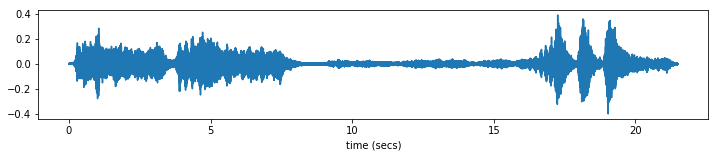

In [9]:
plot_and_listen("audio/beeth5_orch2_21bars.wav")

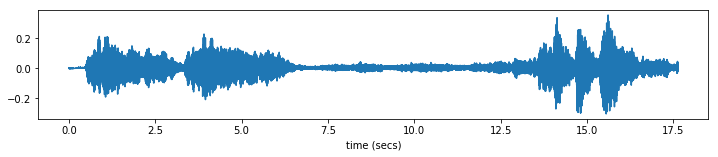

In [10]:
plot_and_listen("audio/beeth5_orch_21bars.wav")

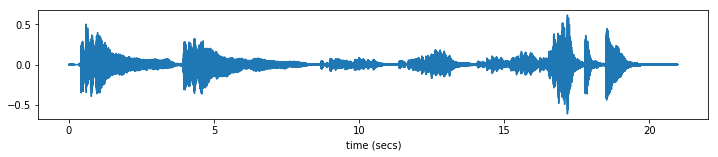

In [11]:
plot_and_listen("audio/beeth5_piano_21bars.wav")

Goal: To automatically find the correspondence between two versions, played at very different tempos.

<img src="images/beeth5_align_arrows.png", width=700>

## Applications

- Help study how two different recordings relate (classical).
- Automatically create a tempo curve via _score informed alignment_.
- Real-time variant of this technique can synchronize a live performance with media playback (LiveNote).
- Automatic accompaniment systems (Sonation).


## Process

- Create a suitable feature representations for each recording
  - Retains musical features / "harmonic content"
  - Removes differences that do not matter: dynamics, instrumentation.
- Alignment process
  - Create a _cost matrix_ 
  - Use an efficient algorithm to find the optimal path through the cost matrix
  
<img src="images/music_sync_process.png" width=700>

We use chroma features as the basis for comparing two recordings:
<img src="images/x_y_alignment.png" width=600>

## Cost Matrix

From the chroma vectors, we create a 2 dimensional _Cost Matrix_.
- It compares every location of one chromagram to every location in the other chromagram
- Chroma $X$ has length $N$ and chroma $Y$ has length $M$.
- The Cost Matrix $\mathbf{C}$ is therefore an $N \times M$ matrix.

<img src="images/cost_matrix.png"  width=600>

To compute $\mathbf{C}$, each element, $\mathbf{C}(n,m)$ is:

$$\mathbf{C}(n,m) = 1 - {\langle x_n, y_m \rangle \over {\Vert x_n \Vert \cdot \Vert y_m \Vert} }$$

This is known as the _cosine distance_ between the two vectors $x_n$ and $y_m$. Properties:
- If $x$ and $y$ are non-negative, $c \in [0, 1]$.
- $c=0$ when vectors point in the same direction.
- In normalized chromagrams, $\Vert x \Vert = 1$ and $\Vert y \Vert = 1$. 
- Very fast to compute.

Note: there are other distance metrics like $\Vert x - y \Vert$.

---

Here is another view of the cost matrix.
- The goal is to find the "best way" of getting from the bottom-left (mutual beginning) to the top-right (mutual ending) of the matrix.
- "Walk along the valley of the cost matrix".

<img src="images/cost_matrix_3d.png"  width=600>

---

## The Optimal Path

Once we find the "best path", we can then create the correspondence between sequence $X$ and sequence $Y$:

<img src="images/dtw_toy_example.png"  width=600>

What is the "best path"?  
It has the lowest _accumulated cost_ of all possible paths.

A path is defined as $P = (p_1, p_2, \ldots , p_L)$ where each $p$ is a pair $(n,m)$.  
The _length_ of $P$ is $L$, the total number of points in the path.

The _accumulated cost_ (or _total cost_) of a certain path $P$ is:

$$ c_P = \sum_{l=1}^L \mathbf{C}(n_l,m_l)$$

## Path Constraints

We define some constrains on a path so it can't just go willy-nilly:
- It must start at $p_1 = (1,1)$ and end at $p_L = (N,M)$.
- It can't go backwards.
- It can only have certain step sizes. We will use these:
  - $\Sigma = \{(1,0), (0,1), (1,1)\}$

Here are some illegal paths:
<img src="images/dtw_illegal_paths.png" width=500>

## Finding the Optimal Path

Finding the optimal path is an optimization problem:  
"Of all possible paths $P$, find the one path $P^*$ that has the lowest total cost"

What's the total number of possible $P$s? It's rather large. An Exhaustive search is infeasible for large values of $N$ and $M$. 

Instead we use a _dynamic programming_ algorithm known as _dynamic time warping_

## Dynamic Time Warping

The overall idea: calculate and keep track of small, _locally optimal sub-solutions_ which then lead the way to the _optimal global solution_.

We introduce a function: $\mathrm{DTW}(X,Y) = c_{P^*}(X,Y)$.  
This means: the total cost of getting from $(1,1)$ to $(N,M)$ for the optimal $P = P^*$.

Next, we introduce an $(N \times M)$ matrix $\mathbf{D}$ - the _accumulated cost matrix_.  
For each cell of $\mathbf{D}$,
$$\mathbf{D}(n,m) = \mathrm{DTW}(X(1:n),Y(1:m)) $$

In other words, $\mathbf{D}$ is filled with the total cost of _subpaths_ of $X$ and $Y$.  
And, of course, $\mathbf{D}(N,M) = \mathrm{DTW}(X,Y)$. 

## Calculating $\mathbf{D}$

The nice thing about matrix $\mathbf{D}$ is that it can be computed iteratively, starting at cell $(1,1)$, visiting each cell _just once_, and finishing at $(N,M)$. This requires $N \cdot M$ "visits" so the total computational complexity is: $O(NM)$.

The procedure for computing $\mathbf{D}$ is:

$$\mathbf{D}(n,1) = \sum_{k=1}^n \mathbf{C}(k,1) \text{ for } n \in[1:N] $$
$$\mathbf{D}(1,m) = \sum_{k=1}^m \mathbf{C}(1,k) \text{ for } m \in[1:M] $$
$$\mathbf{D}(n,m) = \mathbf{C}(n,m) + \mathrm{min}
\begin{cases}
\mathbf{D}(n-1,m) \\
\mathbf{D}(n,m-1) \\
\mathbf{D}(n-1,m-1) \\
\end{cases}$$

Notes:
- This is the case when the step sizes are: $\Sigma = \{(1,0), (0,1), (1,1)\}$.
- The "minimum cost picker" equation does the _local_ optimization.
- The matrix $\mathbf{D}$ serves to "globalize" these local computations.

## Backtracking

The value at $\mathbf{D}(N,M)$ is the minimal cost of getting from $(1,1)$ to $(N,M)$. But we want to also know _what path got us there_.

To do that, for each cell we visit, we remember the _optimizing step_ in a $N \times M$ matrix $\mathbf{B}$ - the _backtracking matrix_.  
$\mathbf{B}$ is a matrix of pointers to cells.

To find the optimal path, start at the end of $\mathbf{B}$ - $(N,M)$, and follow the pointers to $(1,1)$.

<img src="images\dtw_toy_backtracking.png">

## Back to Beethoven

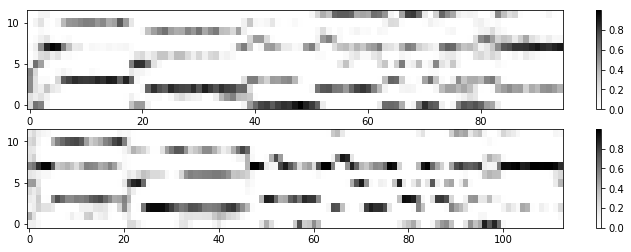

In [12]:
snd1 = load_wav("audio/beeth5_orch_21bars.wav")
snd2 = load_wav("audio/beeth5_piano_21bars.wav")
fs = 22050
fft_len = 4096
hop_size = fft_len / 4

chroma_x = fmp.make_chromagram(snd1, fs, fft_len, hop_size, 0, False)
chroma_x = fmp.cens(chroma_x, 11, 4)

chroma_y = fmp.make_chromagram(snd2, fs, fft_len, hop_size, 0, False)
chroma_y = fmp.cens(chroma_y, 11, 4)

plt.rcParams['figure.figsize'] = (12, 4)
plt.figure()
plot_two_chromas(chroma_x, chroma_y)

(95, 113)


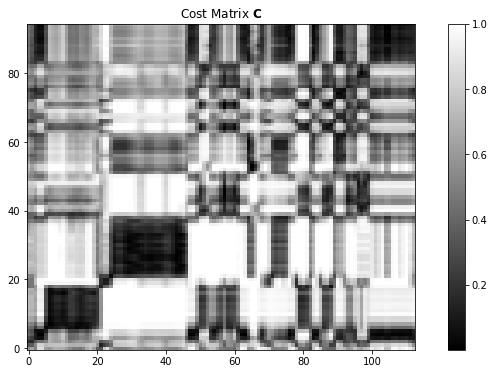

In [13]:
cost = fmp.make_cost_matrix(chroma_x, chroma_y)
print cost.shape

plt.rcParams['figure.figsize'] = (12, 6)
plt.figure()
plt.imshow(cost, origin='lower', cmap='gray');
plt.title("Cost Matrix $\mathbf{C}$")
plt.colorbar();

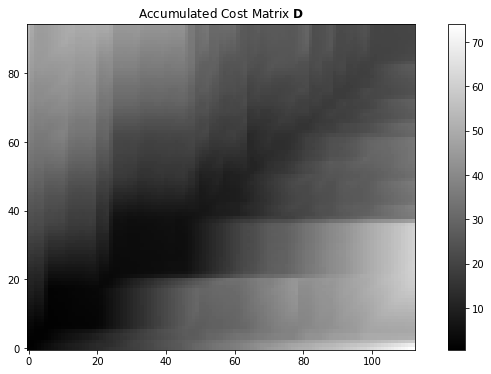

In [14]:
acc, path = fmp.dtw(cost)

plt.figure()
plt.imshow(acc, origin='lower', cmap='gray');
plt.title("Accumulated Cost Matrix $\mathbf{D}$")
plt.colorbar();

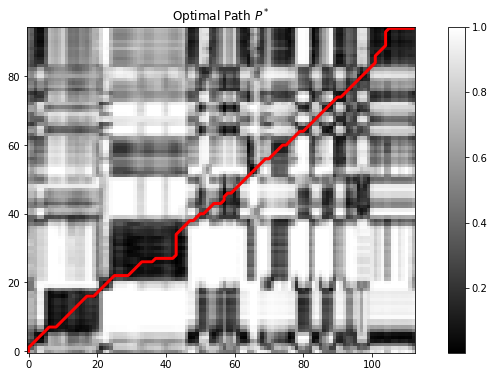

In [15]:
plt.figure()
plt.imshow(cost, origin='lower', cmap='gray');
plt.plot(path[:,1], path[:,0], '-r', linewidth=3)
plt.title("Optimal Path $P^*$")
plt.colorbar();


## DTW Variants

Different step sizes.
  - For example: $\Sigma = \{(2,1), (1,2), (1,1)\}$.  
  This will not allow vertical or horizontal steps.
  
  

Local weights, for example:

$$\mathbf{D}(n,m) = \mathrm{min}
\begin{cases}
\mathbf{D}(n-1,m) + \mathbf{C}(n,m) \\
\mathbf{D}(n,m-1) + \mathbf{C}(n,m) \\
\mathbf{D}(n-1,m-1) + w \cdot \mathbf{C}(n,m) \\
\end{cases}$$

$w < 1$ favors a more diagonal path.  
$w > 1$ favors a more rectangular path.

In [16]:

@interact(w = (0.0, 2.0))
def dtw_w(w = 1.0):
    acc, path = fmp.dtw(cost, fmp.simple_steps_w(w))
    plt.figure()
    plt.imshow(cost, origin='lower', cmap='gray')
    plt.colorbar()
    plt.plot(path[:,1], path[:,0], '-r', linewidth=3)
    plt.show()


interactive(children=(FloatSlider(value=1.0, description=u'w', max=2.0), Output()), _dom_classes=('widget-interact',))

## DTW Optimizations

For large $N$ and $M$, computing $\mathbf{D}$ can be costly. 

### Global Path Constraints
Global constraints reduce the calculations needed, but with some risk:

<img src="images/dtw_global_constraints.png" width=500>

These are:
- The Sakoe-Chiba band
- Itakura parallelogram

### Multiscale Approach
<img src="images/dtw_multiscale.png" width=500>


## Score-Informed Tempo Analysis

Strategy: compare a recording of a piece to an audio rendering of a straight-tempo MIDI version.

- sequence X (vertical) is the MIDI recording
- sequence Y (horizontal) is the performance recording.

In [17]:
fs = 22050.
snd1 = load_wav("audio/chopin_waltz_midi.wav")
midi_bpm = 60.  # 60BPM per bar or 180BPM per quarter note
ipd.Audio(snd1, rate = fs)

In [18]:
snd2 = load_wav("audio/chopin_waltz_langlang.wav")
ipd.Audio(snd2, rate = fs)

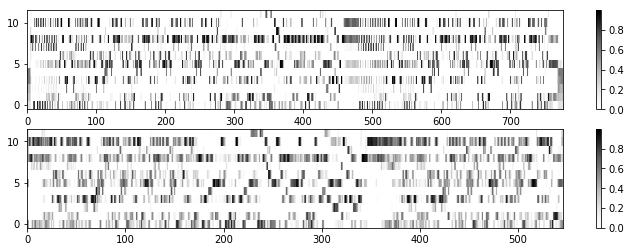

In [19]:
fft_len = 4096
hop_size = fft_len / 4

ds = 4
chroma_x = fmp.make_chromagram(snd1, fs, fft_len, hop_size, 0, False)
chroma_x = fmp.cens(chroma_x, 11, ds)
chroma_y = fmp.make_chromagram(snd2, fs, fft_len, hop_size, 0, False)
chroma_y = fmp.cens(chroma_y, 11, ds)

ff = fs / hop_size / ds

plt.rcParams['figure.figsize'] = (12, 4)
plt.figure()
plot_two_chromas(chroma_x, chroma_y)

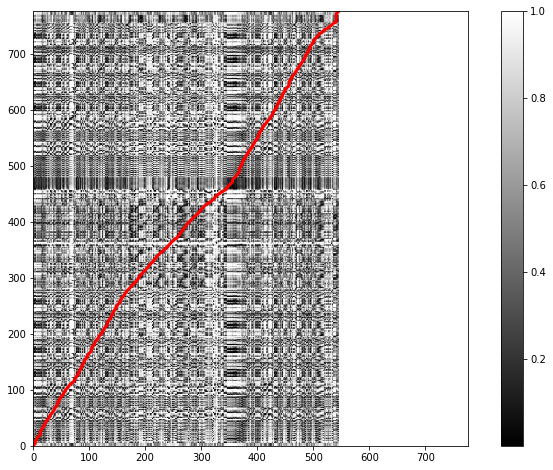

In [20]:
cost = fmp.make_cost_matrix(chroma_x, chroma_y)
path = fmp.dtw(cost, fmp.simple_steps_w(.8))[1]

plt.rcParams['figure.figsize'] = (12, 8)
plt.figure()
plt.imshow(cost, origin='lower', cmap='gray');
plt.colorbar();
plt.plot(path[:,1], path[:,0], '-r', linewidth=3)
plt.xlim(0,cost.shape[0])
plt.ylim(0,cost.shape[0]);

Show that these paths correspond

In [21]:
pp = 400
print 'point on path', path[pp]
print 'as times', path[pp] / ff
start = (path[pp] / ff * fs).astype(int)
print 'as samples', start

point on path [393 273]
as times [ 73.00353741  50.71238095]
as samples [1609728 1118208]


In [22]:
ipd.Audio(snd1[start[0]:start[0] + 100000], rate = fs)

In [23]:
ipd.Audio(snd2[start[1]:start[1] + 100000], rate = fs)

Create a tempo curve from the DTW path:
- Resample curve to have a uniform time axis
- Filter to smooth
- Differentiate to get a "tempo differential function" from the reference tempo

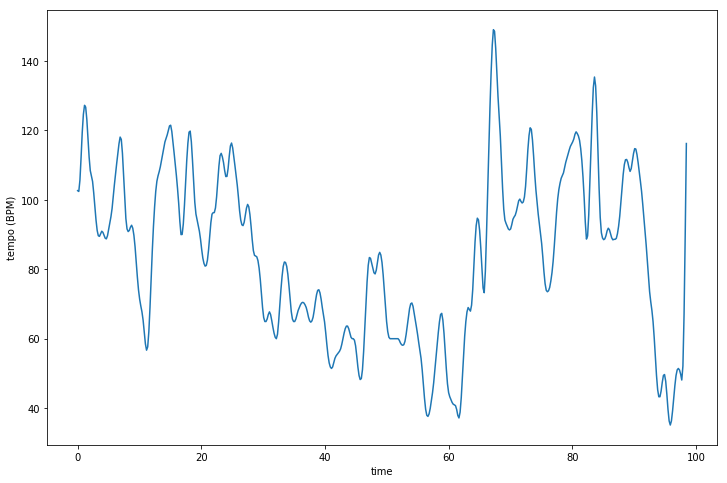

In [24]:
def create_tempo_curve(path, ref_bpm):
    perf = path.T[1]
    ref  = path.T[0]
    perf_len = perf[-1] + 1

    # resample path so that it is a proper signal (one sample per point on x-axis)
    x = np.arange(perf_len)
    ref_times = np.interp(x, perf, ref)
    
    # smooth
    win = np.hanning(15)
    win /= np.sum(win)
    ref_times = np.convolve(ref_times, win, mode='valid')

    # differentiate to get delta_times
    # each delta-time is a time ratio of the reference time to the performance time
    delta_times = ref_times[1:] - ref_times[:-1]
        
    # convert to BPM
    bpms = ref_bpm * delta_times
    
    return bpms
    
tempo = create_tempo_curve(path, midi_bpm)
time_axis = np.arange(len(tempo)) / ff
plt.plot(time_axis, tempo)
plt.xlabel('time')
plt.ylabel('tempo (BPM)')

In [25]:
ipd.Audio(snd2, rate = fs)